In [1]:
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
import pickle

In [2]:
diabetes = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [3]:
diabetes

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [4]:
diabetes.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [5]:
diabetes_profile_report = ProfileReport(diabetes)

In [6]:
diabetes_profile_report

In [7]:
diabetes['BMI'] = diabetes['BMI'].replace(0, diabetes['BMI'].mean())
diabetes['Glucose'] = diabetes['Glucose'].replace(0, diabetes['Glucose'].mean())
diabetes['Insulin'] = diabetes['Insulin'].replace(0, diabetes['Insulin'].mean())
diabetes['BloodPressure'] = diabetes['BloodPressure'].replace(0, diabetes['BloodPressure'].mean())
diabetes['SkinThickness'] = diabetes['SkinThickness'].replace(0, diabetes['SkinThickness'].mean())

In [8]:
diabetes

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [9]:
diabetes_profile_report_1 = ProfileReport(diabetes)

In [10]:
diabetes_profile_report_1

<AxesSubplot:>

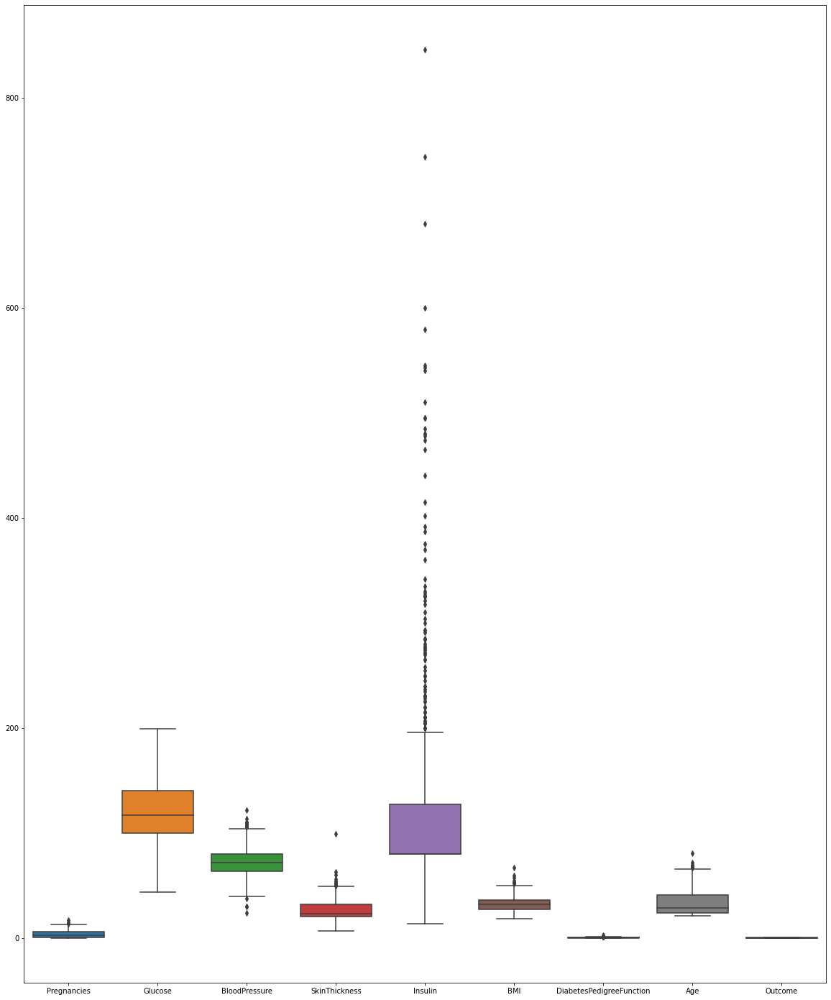

In [11]:
fig, ax = plt.subplots(figsize=(20,25))
sns.boxplot(data=diabetes, ax = ax)

In [12]:
# We can try to delete some data and store (95%) data

q = diabetes['Insulin'].quantile(0.95)
diabetes_new = diabetes[diabetes['Insulin'] < q]

In [13]:
diabetes_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

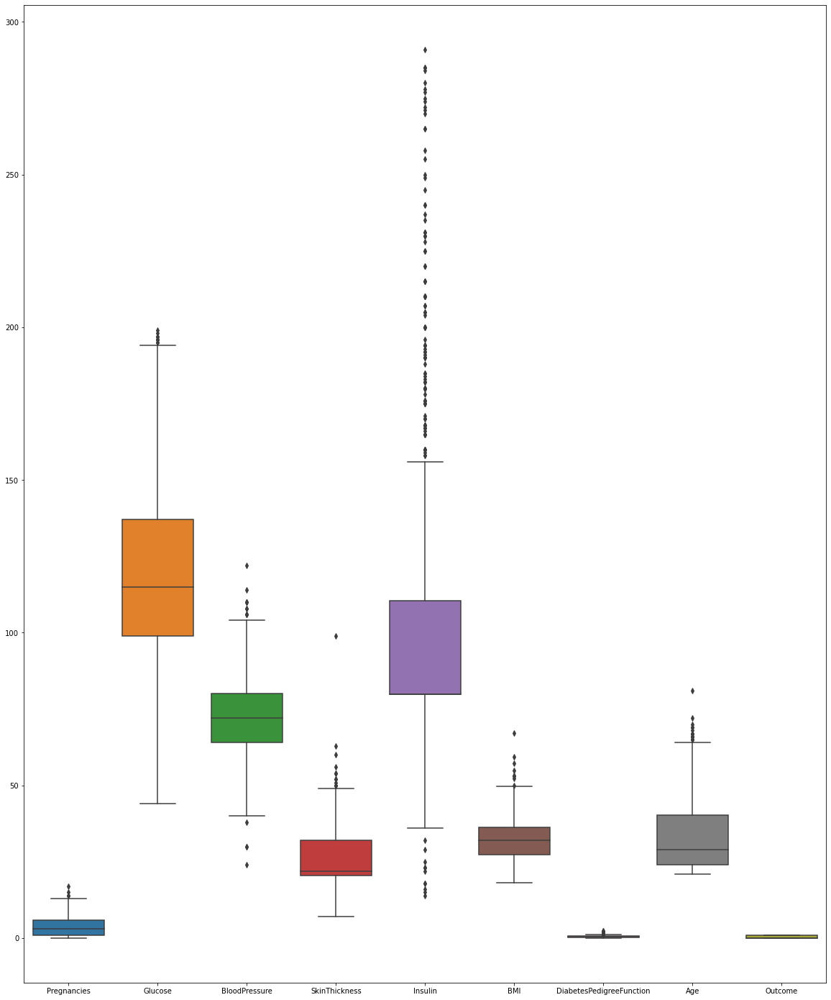

In [14]:
# Graph now changes in this case

fig, ax = plt.subplots(figsize=(20,25))
sns.boxplot(data=diabetes_new, ax = ax)

In [15]:
q = diabetes_new['Insulin'].quantile(0.80)
diabetes_new = diabetes_new[diabetes_new['Insulin'] < q]

In [16]:
diabetes_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

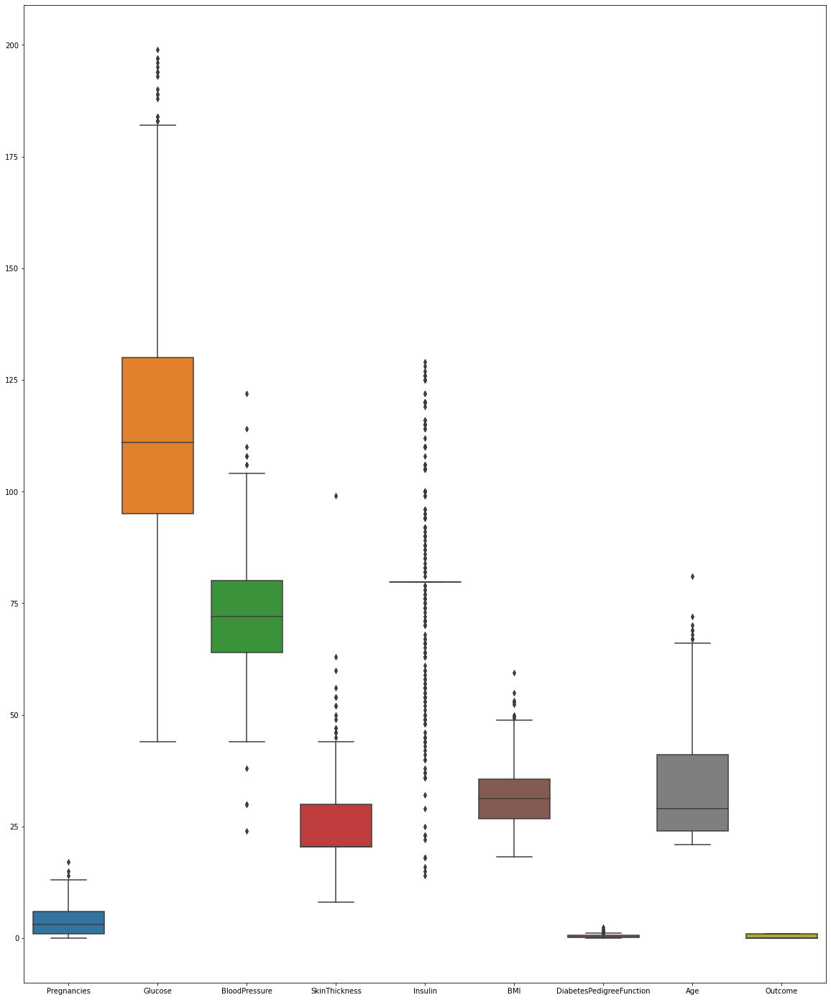

In [17]:
# As you can see when you change the quantile percent, the graph improves, but the the amount of dataset decreases.
# We are losing the data. If quantile is 0.70, it will remove the data above the 70th quantile.

# Graph now changes in this case

fig, ax = plt.subplots(figsize=(20,25))
sns.boxplot(data=diabetes_new, ax = ax)

In [18]:
q = diabetes['Pregnancies'].quantile(0.98)
diabetes_new = diabetes[diabetes['Pregnancies'] < q]

q = diabetes_new['BMI'].quantile(0.99)
diabetes_new = diabetes_new[diabetes_new['BMI'] < q]

q = diabetes_new['SkinThickness'].quantile(0.99)
diabetes_new = diabetes_new[diabetes_new['SkinThickness'] < q]

q = diabetes_new['Insulin'].quantile(0.95)
diabetes_new = diabetes_new[diabetes_new['Insulin'] < q]

q = diabetes_new['DiabetesPedigreeFunction'].quantile(0.98)
diabetes_new = diabetes_new[diabetes_new['DiabetesPedigreeFunction'] < q]

q = diabetes_new['DiabetesPedigreeFunction'].quantile(0.98)
diabetes_new = diabetes_new[diabetes_new['DiabetesPedigreeFunction'] < q]

In [19]:
diabetes_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [20]:
diabetes_profile_report_2 = ProfileReport(diabetes_new)

In [21]:
diabetes_profile_report_2

In [22]:
y = diabetes_new[['Outcome']]

In [23]:
y

,Outcome
0,1
1,0
2,1
3,0
5,0
...,...
763,0
764,0
765,0
766,1


In [24]:
X = diabetes_new.drop(columns=['Outcome'])

In [25]:
X

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [26]:
scaler = StandardScaler()

In [27]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=['Pregnancies','Glucose','BloodPressure','SkinThickness','Insulin','BMI','DiabetesPedigreeFunction','Age'])

In [28]:
X_scaled

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,0.809389,1.003038,0.002997,1.107900,-0.426648,0.273230,0.849083,1.467807
1,-0.865034,-1.168564,-0.503217,0.398213,-0.426648,-0.819244,-0.289082,-0.155661
2,1.479158,2.209484,-0.671956,-0.602864,-0.426648,-1.334267,1.034653,-0.070215
3,-0.865034,-1.030684,-0.503217,-0.311473,-0.135515,-0.585142,-1.047859,-1.010118
4,0.474504,-0.099998,0.171736,-0.602864,-0.426648,-0.975312,-0.907650,-0.241107
...,...,...,...,...,...,...,...,...
657,2.148927,-0.617046,0.340474,2.645554,1.627620,0.163983,-1.031364,2.578601
658,-0.530150,0.106822,-0.165741,0.161651,-0.426648,0.772647,-0.334444,-0.497444
659,0.474504,0.072352,0.002997,-0.311473,0.233513,-0.881671,-0.726204,-0.241107
660,-0.865034,0.244701,-1.009432,-0.602864,-0.426648,-0.273007,-0.297330,1.211470


<AxesSubplot:>

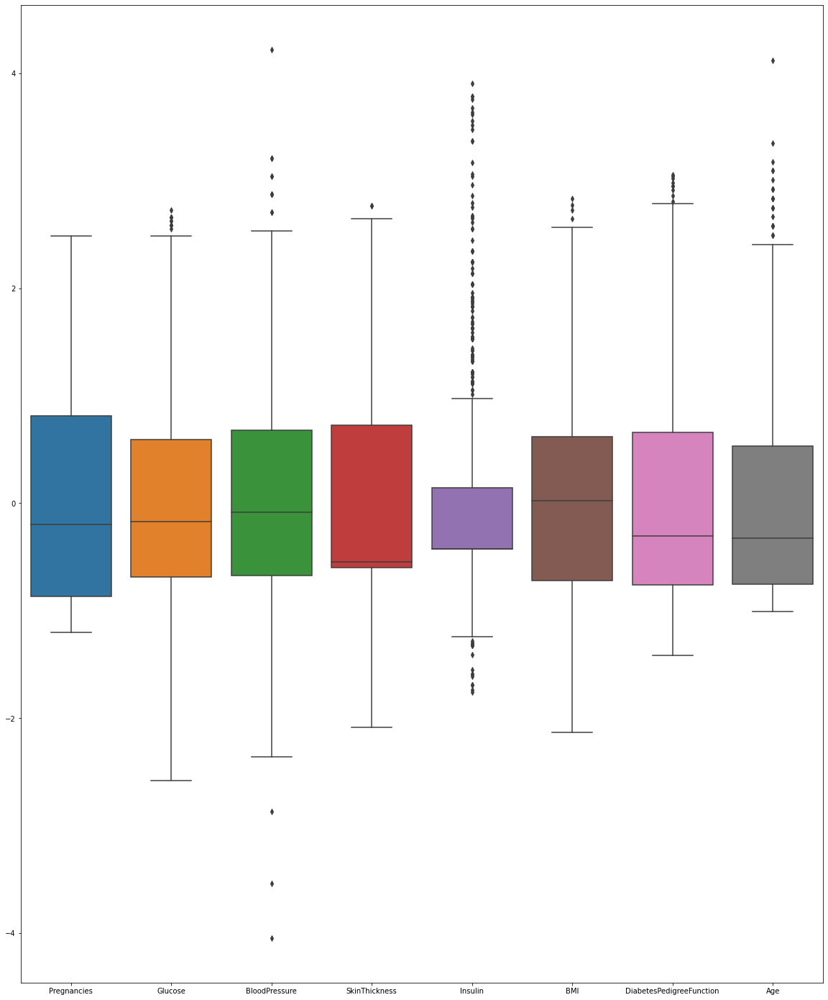

In [29]:
fig, ax = plt.subplots(figsize=(20,25))
sns.boxplot(data=X_scaled, ax=ax)

In [30]:
# VIF Calculation

row, col = X_scaled.shape

arr = scaler.fit_transform(X)

In [31]:
vif_df = pd.DataFrame([[X.columns[i], variance_inflation_factor(arr, i)] for i in range(col)], 
                      columns=['Feature','VIF Value'])

In [32]:
vif_df

,Feature,VIF Value
0,Pregnancies,1.387506
1,Glucose,1.307822
2,BloodPressure,1.254458
3,SkinThickness,1.460044
4,Insulin,1.292036
5,BMI,1.504806
6,DiabetesPedigreeFunction,1.053790
7,Age,1.574706


In [33]:
# Train, Test, Split of Data

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.25, random_state=2307)

In [34]:
X_train.shape

(496, 8)

In [35]:
y_train.shape

(496, 1)

In [36]:
X_test.shape

(166, 8)

In [37]:
y_test.shape

(166, 1)

In [41]:
# Logistic Regression - OVO (One vs One)

log_reg = LogisticRegression(verbose=5)

In [42]:
log_reg.fit(X_train, y_train)

C:\Users\Dell\anaconda3\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s finished


LogisticRegression(verbose=5)

In [44]:
log_reg.fit(X_train, y_train)

C:\Users\Dell\anaconda3\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s finished


LogisticRegression(verbose=5)

In [50]:
test_sample = X_test[0:1]
test_sample

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
548,-1.199919,-0.582576,1.184166,-1.02116,0.090002,-0.397861,1.1295,-0.497444


In [52]:
log_reg.predict(test_sample)

array([0], dtype=int64)

In [54]:
log_reg.predict_proba(test_sample)

array([[0.9241147, 0.0758853]])

In [55]:
log_reg.predict_log_proba(test_sample)

array([[-0.07891908, -2.57853233]])

In [57]:
y_test[0:1]

# Actual and predited output matches

,Outcome
640,0
